# Часть III проекта "Прогнозирование стоимости жилья". 

* Улучшенная подготовка данных и отбор признаков.
* Построение моделей:
 - Линейная регрессия.
 - Дерево решений.
 - Градиентный бустинг.
 - Случайный лес.
 - Catboost.

In [1]:
# импортируем библиотеки

import pandas as pd
import numpy as np

import category_encoders as ce

from sklearn import preprocessing
from sklearn.feature_selection import f_classif
from sklearn import model_selection

from sklearn import linear_model
from sklearn import metrics
from sklearn import tree

from sklearn.model_selection import RandomizedSearchCV
from sklearn import ensemble
from catboost import CatBoostRegressor
from hyperopt import hp, fmin, STATUS_OK, STATUS_FAIL

import seaborn as sns
import plotly.express as px
import matplotlib.pyplot as plt
%matplotlib inline

import warnings
warnings.filterwarnings("ignore")

## Мы вернулись к обработке данных.
Попробуем обработать их немного по-другому и посмотрим, как это повлияет на наши модели.

### Разберем все признаки.

In [2]:
data_copy2 = pd.read_csv('./data/processed_data.csv')
data_copy2.head(3)

,status,propertyType,fireplace,sqft,beds,state,stories,target,Year built,Heating,Cooling,Parking,lotsize,Price/sqft,school_rating_count,privatePool,propertyTypeCount,MLS
0,active,single family,1,2900.0,4.0,NC,0.0,418000,2019.0,central,no data,no data,0.0,144.0,8,False,1,True
1,for sale,single family,0,1947.0,3.0,WA,2.0,310000,2019.0,no data,no data,no data,0.0,159.0,3,False,1,True
2,for sale,single family,1,3000.0,3.0,CA,1.0,2895000,1961.0,forced air,central,attached,0.0,965.0,3,True,1,True


Я довольно хорошо изучила все признаки в процессе выполнения проекта, поэтому удалю часть "неугодных", после чего посерьезнее поработаю с выбросами.

In [3]:
data_copy2 = data_copy2.drop(['Heating', 'Cooling', 'Parking'], axis=1)

#### Целевой признак target

In [4]:
# Визуализирую разброс стоимости
fig = px.box(
    data_frame=data_copy2,
    x = data_copy2['target'],
    title='Распределение стоимости недвижимости',
    color_discrete_sequence=px.colors.diverging.Tealrose,
    log_x=True
)
fig.show()

<img src="visualisation/17.png?raw=true">

Поищу выбросы не вручную, а с помощью метода межквартильного размаха.

In [5]:
# создам функцию 
def outliers_iqr(data, feature):
    x = data[feature]
    quartile_1, quartile_3 = x.quantile(0.25), x.quantile(0.75),
    iqr = quartile_3 - quartile_1
    lower_bound = quartile_1 - (iqr * 1.5)
    upper_bound = quartile_3 + (iqr * 1.5)
    outliers = data[(x<lower_bound) | (x > upper_bound)]
    cleaned = data[(x>lower_bound) & (x < upper_bound)]
    return outliers, cleaned

outliers, cleaned = outliers_iqr(data_copy2, 'target')
print(f'Число выбросов по методу Тьюки: {outliers.shape[0]}')
print(f'Результирующее число записей: {cleaned.shape[0]}')

Число выбросов по методу Тьюки: 30380
Результирующее число записей: 278621


#### Признак sqft.

In [6]:
# Визуализирую разброс площадей
fig = px.box(
    data_frame=data_copy2,
    x = data_copy2['sqft'],
    title='Распределение площади недвижимости',
    color_discrete_sequence=px.colors.diverging.Tealrose,
    log_x=True
)
fig.show()

<img src="visualisation/18.png?raw=true">

In [7]:
# удалю выбросы
outliers, cleaned = outliers_iqr(cleaned, 'sqft')
print(f'Число выбросов по методу Тьюки: {outliers.shape[0]}')
print(f'Результирующее число записей: {cleaned.shape[0]}')

Число выбросов по методу Тьюки: 9280
Результирующее число записей: 269322


#### Признак beds.

In [8]:
# Визуализирую разброс количества спален.
fig = px.box(
    data_frame=cleaned,
    x = cleaned['beds'],
    title='Распределение количества спален',
    color_discrete_sequence=px.colors.diverging.Tealrose,
    log_x=True
)
fig.show()

<img src="visualisation/19.png?raw=true">

In [9]:
# воспользуюсь методом межквартильного размаха для очистки от выбросов

outliers, cleaned = outliers_iqr(cleaned, 'beds')
print(f'Число выбросов по методу Тьюки: {outliers.shape[0]}')
print(f'Результирующее число записей: {cleaned.shape[0]}')

Число выбросов по методу Тьюки: 14633
Результирующее число записей: 254689


#### Признак stories

In [10]:
fig = px.box(
    data_frame=cleaned,
    x = cleaned['stories'],
    title='Распределение количества этажей',
    color_discrete_sequence=px.colors.diverging.Tealrose,
    log_x=True
)
fig.show()

<img src="visualisation/20.png?raw=true">

In [11]:
# воспользуюсь методом межквартильного размаха для очистки от выбросов

outliers, cleaned = outliers_iqr(cleaned, 'stories')
print(f'Число выбросов по методу Тьюки: {outliers.shape[0]}')
print(f'Результирующее число записей: {cleaned.shape[0]}')

Число выбросов по методу Тьюки: 4525
Результирующее число записей: 249627


#### Признак lotsize.

In [12]:
fig = px.box(
    data_frame=cleaned,
    x = cleaned['lotsize'],
    title='Распределение lotsize',
    color_discrete_sequence=px.colors.diverging.Tealrose,
    log_x=True
)
fig.show()

<img src="visualisation/21.png?raw=true">

Большая часть признака занято нулевыми значениями. Удалим признак.

In [13]:
cleaned = cleaned.drop(['lotsize'], axis=1)
cleaned.head(2)

,status,propertyType,fireplace,sqft,beds,state,stories,target,Year built,Price/sqft,school_rating_count,privatePool,propertyTypeCount,MLS
0,active,single family,1,2900.0,4.0,NC,0.0,418000,2019.0,144.0,8,False,1,True
1,for sale,single family,0,1947.0,3.0,WA,2.0,310000,2019.0,159.0,3,False,1,True


## Подготовка данных.

In [14]:
# посмотрим на основную информацию о нечисловых признаках
cleaned.describe(include='object')

,status,propertyType,state
count,249627,249627,249627
unique,40,28,36
top,for sale,single family,FL
freq,131216,145632,77534


Для кодирования нам подходит Binary Encoding.

In [15]:
# закодируем признаки
object_columns_list = ['status', 'propertyType', 'state']
bin_encoder = ce.BinaryEncoder(cols=object_columns_list)
type_bin = bin_encoder.fit_transform(cleaned[object_columns_list])
cleaned_encoding = pd.concat([cleaned, type_bin], axis=1)

# удалим закодированные признаки
cleaned_encoding.drop(object_columns_list, axis=1 , inplace=True)

cleaned_encoding.head(3)

,fireplace,sqft,beds,stories,target,Year built,Price/sqft,school_rating_count,privatePool,propertyTypeCount,...,propertyType_1,propertyType_2,propertyType_3,propertyType_4,state_0,state_1,state_2,state_3,state_4,state_5
0,1,2900.0,4.0,0.0,418000,2019.0,144.0,8,False,1,...,0,0,0,1,0,0,0,0,0,1
1,0,1947.0,3.0,2.0,310000,2019.0,159.0,3,False,1,...,0,0,0,1,0,0,0,0,1,0
4,0,897.0,2.0,2.0,209000,1920.0,233.0,0,False,1,...,0,0,1,0,0,0,0,0,1,1


### Корреляция признаков.

In [16]:
# создадим список всех колонок
all_columns = cleaned_encoding.columns.tolist()

# непрерывные признаки:
num_cols = ['fireplace', 'sqft', 'beds', 
            'stories', 'Price/sqft',
            'school_rating_count', 'propertyTypeCount'
            ]

# категориальные признаки:
cat_cols = all_columns.copy()

for item in num_cols:
    cat_cols.remove(item)
    
cat_cols.remove('target')

print(f'{len(num_cols)} непрерывных признаков: {num_cols}')
print(f'{len(cat_cols)} категориальных признаков: {cat_cols}')

7 непрерывных признаков: ['fireplace', 'sqft', 'beds', 'stories', 'Price/sqft', 'school_rating_count', 'propertyTypeCount']
20 категориальных признаков: ['Year built', 'privatePool', 'MLS', 'status_0', 'status_1', 'status_2', 'status_3', 'status_4', 'status_5', 'propertyType_0', 'propertyType_1', 'propertyType_2', 'propertyType_3', 'propertyType_4', 'state_0', 'state_1', 'state_2', 'state_3', 'state_4', 'state_5']


In [17]:
cleaned_encoding.head(1)

,fireplace,sqft,beds,stories,target,Year built,Price/sqft,school_rating_count,privatePool,propertyTypeCount,...,propertyType_1,propertyType_2,propertyType_3,propertyType_4,state_0,state_1,state_2,state_3,state_4,state_5
0,1,2900.0,4.0,0.0,418000,2019.0,144.0,8,False,1,...,0,0,0,1,0,0,0,0,0,1


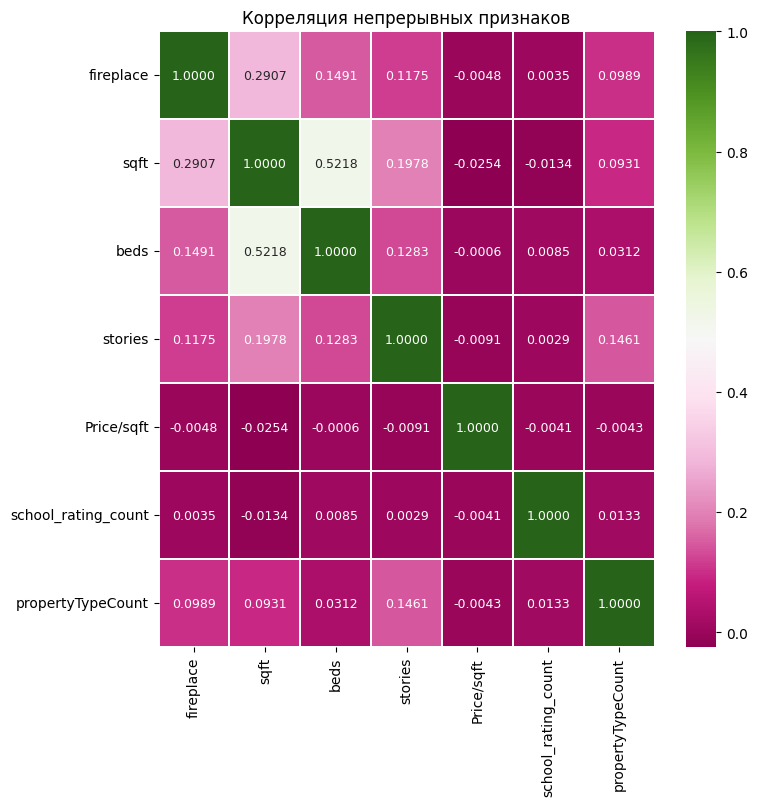

In [18]:
# построим матрицу корреляции для непрерывнх признаков

fig_, ax_ = plt.subplots(figsize=(8, 8))
corr = cleaned_encoding[num_cols].corr(method='pearson')
sns.heatmap(corr, 
            annot=True, 
            annot_kws={"fontsize":9}, 
            linewidths=0.1, 
            ax=ax_, 
            cmap='PiYG',
            fmt='.4f')
ax_.set_title('Корреляция непрерывных признаков', fontsize=12)
plt.show()

Сильно скоррелированных признаков не обнаружено.

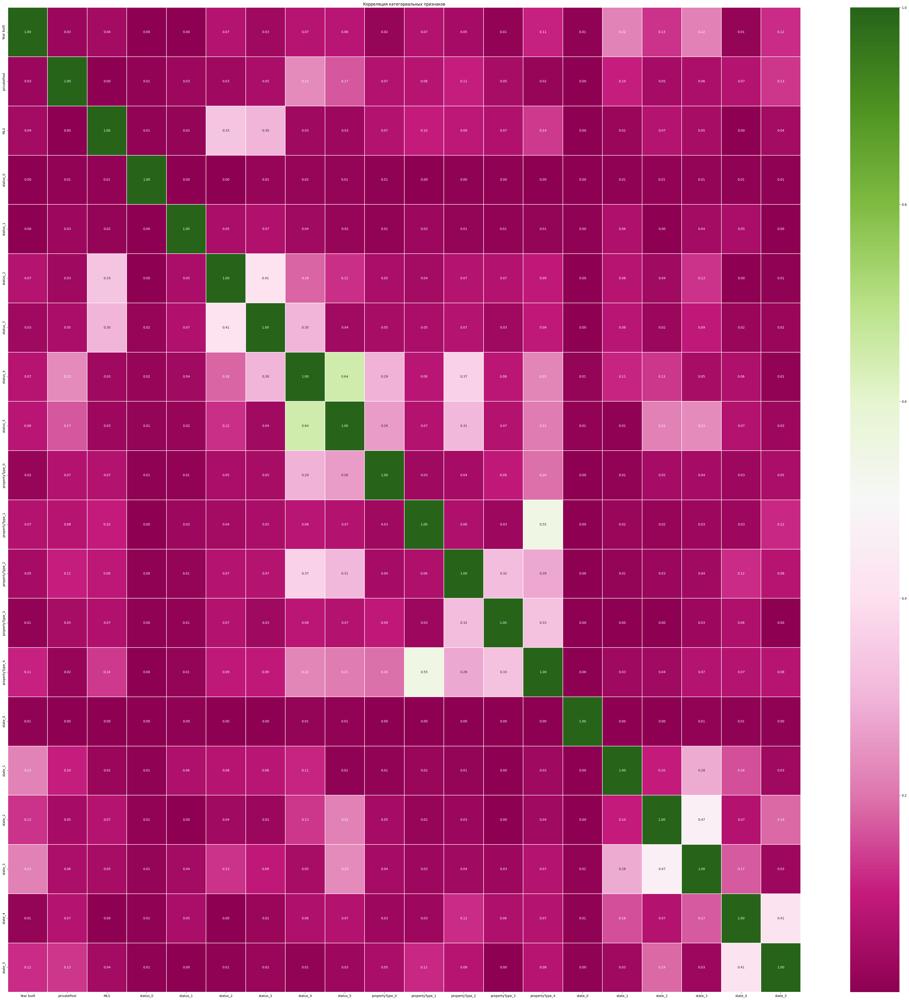

In [19]:
# построим матрицу корреляции для категориальных признаков

fig_, ax_ = plt.subplots(figsize=(55, 55))
corr = cleaned_encoding[cat_cols].corr(method='spearman').abs()
sns.heatmap(corr, 
            annot=True, 
            annot_kws={"fontsize":10}, 
            linewidths=0.1, 
            ax=ax_, 
            cmap='PiYG',
            fmt='.2f')
ax_.set_title('Корреляция категориальных признаков', fontsize=12)
plt.show()

Высоко скоррелированных признаков не обнаружено. Проведу оценку значимости всех признаков с помощью теста ANOVA.

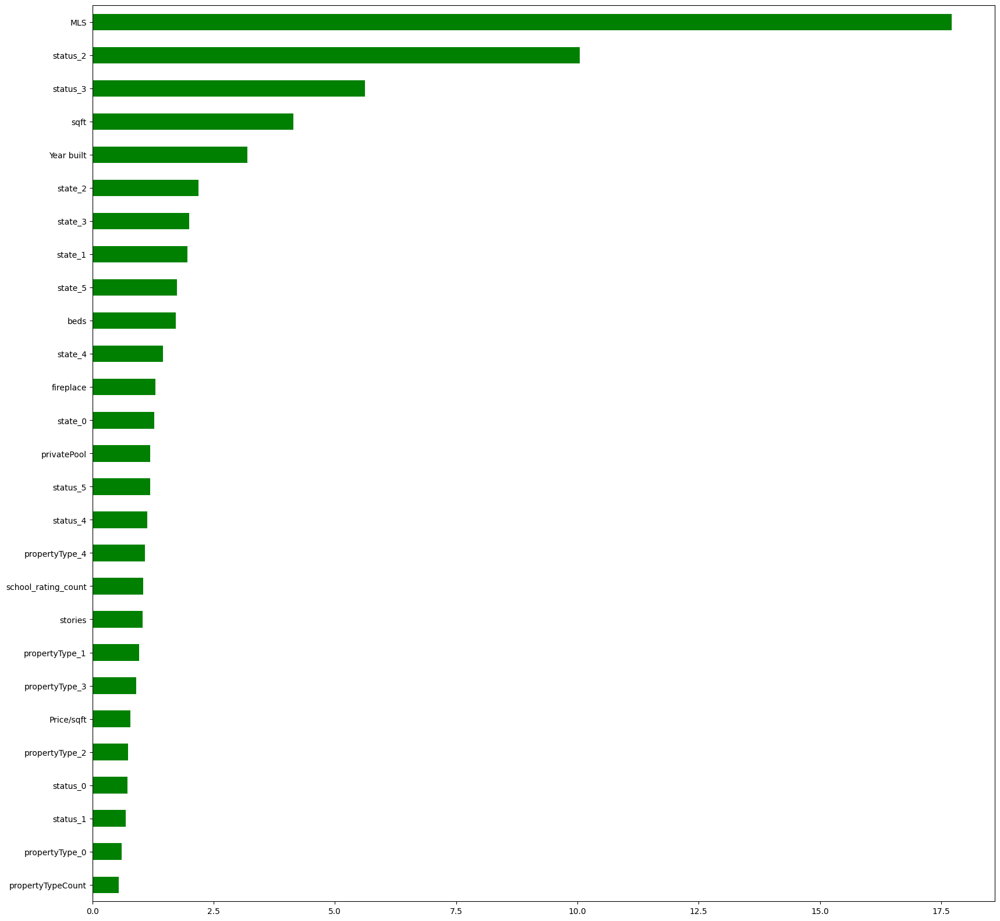

In [20]:
# выделим целевой признак
y = cleaned_encoding.target.values
X = cleaned_encoding.drop(['target'], axis=1)

# визуализируем результат анализа значимости:
imp_num = pd.Series(f_classif(
    X[X.columns], y = cleaned_encoding.target.values
    )[0], index = X.columns)
imp_num.sort_values(inplace = True)

fig5, ax5 = plt.subplots(figsize=(20, 20))
imp_num.plot(kind = 'barh', color='green');

У нас не так много признаков, поэтому оставим все.

Разделим набор данных на матрицу наблюдений X (таблица из объектов и их признаков) и столбец правильных ответов y.

Разделяем всю выборку на тренировочную и тестовую в соотношении 80/20.

На тренировочной выборке будем обучать модели, а на тестовой проверять их качество. 

In [21]:
# X - матрица наблюдений, y - столбец правильных ответов
X = cleaned_encoding.drop('target', axis=1)
y = cleaned_encoding['target']

#Создаем тренировочную и тестовую выборки с помощью train_test_split
X_train, X_test, y_train, y_test = model_selection.train_test_split(
    X, y, #таблица с наблюдениями и столбец с правильным ответами
    test_size=0.2, #размер тестовой выборки
    random_state=40 #число отвечающее за генерацию случайных чисел
)
#Выводим размеры полученных выборок
print('Train shape: {}'.format(X_train.shape))
print('Test shape: {}'.format(X_test.shape))

Train shape: (199701, 27)
Test shape: (49926, 27)


## Вернемся к построению моделей.

Создадим функцию, которая будет расчитывать метрики:

1. MAE - средняя абсолютная ошибка (целевая метрика)
2. MAPE - средняя абсолютная ошибка в процентах 
3. $R^2$ - коэффициент детерминации 

In [22]:
def print_metrics(y_train, y_train_predict, y_test, y_test_predict):
    print('Train R^2: {:.3f}'.format(metrics.r2_score(y_train, y_train_predict)))
    print('Train MAE: {:.3f}'.format(metrics.mean_absolute_error(y_train, y_train_predict)))
    print('Train MAPE: {:.3f}'.format(metrics.mean_absolute_percentage_error(y_train, y_train_predict)*100))
    print('\n')
    print('Test R^2: {:.3f}'.format(metrics.r2_score(y_test, y_test_predict)))
    print('Test MAE: {:.3f}'.format(metrics.mean_absolute_error(y_test, y_test_predict)))
    print('Test MAPE: {:.3f}'.format(metrics.mean_absolute_percentage_error(y_test, y_test_predict)*100))

### Линейная регрессия.

In [23]:
#Инициализируем объект класса линейная регрессия
lr = linear_model.LinearRegression()

#Обучаем модель - ищем параметры
lr.fit(X_train, y_train)

#Делаем предсказание для каждой из выборок
y_train_pred = lr.predict(X_train)
y_test_pred = lr.predict(X_test)

#Выводим результирующие метрики
print_metrics(y_train, y_train_pred, y_test, y_test_pred)

Train R^2: 0.311
Train MAE: 141666.809
Train MAPE: 314.726


Test R^2: 0.302
Test MAE: 142800.342
Test MAPE: 826.287


Если сравнить результат работы этой модели на новых данных с результатами полученными на точно такой же модели на предыдущей(очень аккуратно обработанной) версии данных, то можно увидеть, что новый вариант показывает лучшие метрики. 

Сгенерируем полиномиальные признаки 2-ой степени с помощью PolynomialFeatures из библиотеки sklearn.

In [24]:
#Создаём генератор полиномиальных признаков
poly = preprocessing.PolynomialFeatures(degree=2, include_bias=False)
poly.fit(X_train)

#Генерируем полиномиальные признаки для тренировочной выборки
X_train_poly = poly.transform(X_train)

#Генерируем полиномиальные признаки для валидационной выборки
X_test_poly = poly.transform(X_test)

#Создаём объект класса LinearRegression
lr_model_poly = linear_model.LinearRegression()

#Обучаем модель по МНК
lr_model_poly.fit(X_train_poly, y_train)

#Делаем предсказание для тренировочной выборки
y_train_predict_poly = lr_model_poly.predict(X_train_poly)
#Делаем предсказание для тестовой выборки
y_test_predict_poly = lr_model_poly.predict(X_test_poly)
 
#Выводим результирующие метрики
print_metrics(y_train, y_train_predict_poly, y_test, y_test_predict_poly)

Train R^2: 0.923
Train MAE: 31211.821
Train MAPE: 78.084


Test R^2: 0.760
Test MAE: 31686.191
Test MAPE: 147.805


#### Сделаем нормализацию числовых признаков и построим аналогичную модель.

In [25]:
#Создаем объект для min-max нормализации
scaler = preprocessing.MinMaxScaler()

#Вычисляем параметры для нормализации - min и max для каждого столбца
scaler.fit(X_train)

#Производим преобразование для каждой из выборок
X_train_scaled = scaler.transform(X_train)
X_test_scaled = scaler.transform(X_test)

#Создаем объект для генерации полиномиальных признаков степени 2
poly = preprocessing.PolynomialFeatures(degree=2, include_bias=False)
#Вычисляем параметры генерации - результирующее количество признак
poly.fit(X_train_scaled)

#Производим преобразование для каждой из выборок
X_train_scaled_poly = poly.transform(X_train_scaled)
X_test_scaled_poly = poly.transform(X_test_scaled)

print('Train shape: {}'.format(X_train_scaled_poly.shape))
print('Test shape: {}'.format(X_test_scaled_poly.shape))

Train shape: (199701, 405)
Test shape: (49926, 405)


In [26]:
#Создаём объект класса LinearRegression
lr_model_poly = linear_model.LinearRegression()

#Обучаем модель по МНК
lr_model_poly.fit(X_train_scaled_poly, y_train)

#Делаем предсказание для тренировочной выборки
y_train_predict_poly = lr_model_poly.predict(X_train_scaled_poly)
#Делаем предсказание для тестовой выборки
y_test_predict_poly = lr_model_poly.predict(X_test_scaled_poly)
 
#Выводим результирующие метрики
print_metrics(y_train, y_train_predict_poly, y_test, y_test_predict_poly)

Train R^2: 0.923
Train MAE: 31232.535
Train MAPE: 78.493


Test R^2: 0.760
Test MAE: 31711.133
Test MAPE: 148.155


Результат на тестовых данных незначительно ухудшился.

### Построим модель дерева решений (DecisionTreeRegressor).

In [27]:
#Создаём объект класса DecisionTreeRegressor
dt = tree.DecisionTreeRegressor()

#Обучаем модель
dt.fit(X_train, y_train)

#Делаем предсказание для тренировочной выборки
y_train_predict_dt = dt.predict(X_train)
#Делаем предсказание для тестовой выборки
y_test_predict_dt = dt.predict(X_test)

#Выводим результирующие метрики
print_metrics(y_train, y_train_predict_dt, y_test, y_test_predict_dt)

Train R^2: 0.998
Train MAE: 530.041
Train MAPE: 0.209


Test R^2: 0.956
Test MAE: 9184.658
Test MAPE: 14.802


Дерево получилось переобученным. На тренировочных данных показывает почти идеальный результат, а на тестовых, увы, ошибается.

### Построю модель градиентного бустинга над деревьями решений. Параметры возьму на свое усмотрение.

In [28]:
# Создаем объект класса градиентный бустинг
gb = ensemble.GradientBoostingRegressor(
    max_depth=3, #максимальная глубина дерева
    n_estimators=50, #количество деревьев в ансамбле
    random_state=42, #датчик генератора случайных чисел
    min_samples_split=20,
    learning_rate=0.5
)

#Обучаем модель
gb.fit(X_train, y_train)

#Делаем предсказание для тренировочной выборки
y_train_predict_gb = gb.predict(X_train)
#Делаем предсказание для тестовой выборки
y_test_predict_gb = gb.predict(X_test)

#Выводим результирующие метрики
print_metrics(y_train, y_train_predict_gb, y_test, y_test_predict_gb)

Train R^2: 0.958
Train MAE: 22537.535
Train MAPE: 127.390


Test R^2: 0.957
Test MAE: 22620.630
Test MAPE: 311.122


#### Настроим оптимизацию гиперпараметров для модели градиентного бустинга с помощью RandomizedSearchCV.

In [29]:
# задаем значения гиперпараметров
param_distributions = {
    'max_depth': list(np.arange(1, 8, 1)),
    'n_estimators': list(np.arange(50, 100, 4)), 
    'min_samples_leaf' : list(np.arange(1, 30, 3)),
    'learning_rate': list(np.linspace(0.01, 1, 20, dtype=float))
    }

random_search_gb = RandomizedSearchCV(
    estimator=ensemble.GradientBoostingRegressor(random_state=42), 
    param_distributions=param_distributions, 
    cv=5,
    n_iter = 10, 
    n_jobs = -1,
    )

%time random_search_gb.fit(X_train, y_train) 

#Делаем предсказание для тренировочной выборки
y_train_predict_gb = random_search_gb.predict(X_train)
#Делаем предсказание для тестовой выборки
y_test_predict_gb = random_search_gb.predict(X_test)

#Выводим результирующие метрики
print_metrics(y_train, y_train_predict_gb, y_test, y_test_predict_gb)

print("Наилучшие значения гиперпараметров: {}".format(random_search_gb.best_params_))

CPU times: total: 44.9 s
Wall time: 4min 48s
Train R^2: 0.978
Train MAE: 11303.680
Train MAPE: 122.454


Test R^2: 0.973
Test MAE: 12082.862
Test MAPE: 317.487
Наилучшие значения гиперпараметров: {'n_estimators': 90, 'min_samples_leaf': 10, 'max_depth': 6, 'learning_rate': 0.2705263157894737}


### Вернемся к модели DecisionTreeRegressor, подобрав параметры с помощью RandomizedSearchCV.

In [30]:
# построим модель с параметрами "пальцем в небо"
#Создаём объект класса DecisionTreeRegressor
dt = tree.DecisionTreeRegressor(max_depth=8,
                                min_samples_leaf=40,
                                min_samples_split=80,
                                random_state=42
                            )

#Обучаем модель
dt.fit(X_train, y_train)

#Делаем предсказание для тренировочной выборки
y_train_predict_dt = dt.predict(X_train)
#Делаем предсказание для тестовой выборки
y_test_predict_dt = dt.predict(X_test)

#Выводим результирующие метрики
print_metrics(y_train, y_train_predict_dt, y_test, y_test_predict_dt)

Train R^2: 0.951
Train MAE: 25108.608
Train MAPE: 192.782


Test R^2: 0.949
Test MAE: 25368.765
Test MAPE: 427.369


In [31]:
# задаем значения гиперпараметров
param_distributions = {'min_samples_split': [10, 20, 40],
              'max_depth': [2, 6, 8],
              'min_samples_leaf': [20, 40, 100],
              }

random_search_dt = RandomizedSearchCV(
    estimator=tree.DecisionTreeRegressor(random_state=42), 
    param_distributions=param_distributions,
    cv=5,
    n_iter = 10, 
    n_jobs = -1,
    )

%time random_search_dt.fit(X_train, y_train) 

#Делаем предсказание для тренировочной выборки
y_train_predict_dt = random_search_dt.predict(X_train)
#Делаем предсказание для тестовой выборки
y_test_predict_dt = random_search_dt.predict(X_test)

#Выводим результирующие метрики
print_metrics(y_train, y_train_predict_dt, y_test, y_test_predict_dt)

print("Наилучшие значения гиперпараметров: {}".format(random_search_dt.best_params_))

CPU times: total: 1.42 s
Wall time: 4.92 s
Train R^2: 0.951
Train MAE: 25108.608
Train MAPE: 192.782


Test R^2: 0.949
Test MAE: 25368.765
Test MAPE: 427.369
Наилучшие значения гиперпараметров: {'min_samples_split': 10, 'min_samples_leaf': 40, 'max_depth': 8}


### Попробуем модель случайного леса.

In [32]:
#Создаём объект класса DecisionTreeRegressor
rf = ensemble.RandomForestRegressor(
    max_depth=50,
    n_estimators=10, 
    random_state=42
    )

#Обучаем модель
rf.fit(X_train, y_train)

#Делаем предсказание для тренировочной выборки
y_train_predict_rf = rf.predict(X_train)
#Делаем предсказание для тестовой выборки
y_test_predict_rf = rf.predict(X_test)

#Выводим результирующие метрики
print_metrics(y_train, y_train_predict_rf, y_test, y_test_predict_rf)

Train R^2: 0.994
Train MAE: 3251.655
Train MAPE: 22.609


Test R^2: 0.971
Test MAE: 7550.979
Test MAPE: 371.019


In [33]:
# Подберем параметры для модели случайного леса.
# задаем значения гиперпараметров
param_distributions = {'max_depth': list(np.arange(10, 100, 10)),
              'n_estimators' : list(np.arange(2, 40, 2))
              }

random_search_rf = RandomizedSearchCV(
    estimator=ensemble.RandomForestRegressor(random_state=42), 
    param_distributions=param_distributions,
    cv=5,
    n_iter = 10, 
    n_jobs = -1,
    )

%time random_search_rf.fit(X_train, y_train) 

#Делаем предсказание для тренировочной выборки
y_train_predict_rf = random_search_rf.predict(X_train)
#Делаем предсказание для тестовой выборки
y_test_predict_rf = random_search_rf.predict(X_test)

#Выводим результирующие метрики
print_metrics(y_train, y_train_predict_rf, y_test, y_test_predict_rf)

print("Наилучшие значения гиперпараметров: {}".format(random_search_rf.best_params_))

CPU times: total: 1min 38s
Wall time: 6min 40s
Train R^2: 0.992
Train MAE: 3756.792
Train MAPE: 33.633


Test R^2: 0.973
Test MAE: 7134.318
Test MAPE: 435.664
Наилучшие значения гиперпараметров: {'n_estimators': 38, 'max_depth': 20}


### Давайте попробуем воспользоваться CatBoost.
Для этого можно слегка видоизменить выборки, так как, насколько мне известно, CatBoost может работать с категориальными признаками без обработки. 

In [34]:
data_for_catboost = cleaned.copy()
data_for_catboost.head(2)

,status,propertyType,fireplace,sqft,beds,state,stories,target,Year built,Price/sqft,school_rating_count,privatePool,propertyTypeCount,MLS
0,active,single family,1,2900.0,4.0,NC,0.0,418000,2019.0,144.0,8,False,1,True
1,for sale,single family,0,1947.0,3.0,WA,2.0,310000,2019.0,159.0,3,False,1,True


In [35]:
#X - матрица наблюдений, y - столбец правильных ответов
X_cb = data_for_catboost.drop('target', axis=1)
y_cb = data_for_catboost['target']

#Создаем тренировочную и тестовую выборки с помощью train_test_split
X_train_cb, X_test_cb, y_train_cb, y_test_cb = model_selection.train_test_split(
    X_cb, y_cb, #таблица с наблюдениями и столбец с правильным ответами
    test_size=0.2, #размер тестовой выборки
    random_state=40 #число отвечающее за генерацию случайных чисел
)
#Выводим размеры полученных выборок
print('Train shape: {}'.format(X_train_cb.shape))
print('Test shape: {}'.format(X_test_cb.shape))

Train shape: (199701, 13)
Test shape: (49926, 13)


In [36]:
types = X_cb.dtypes
cat_features = list(types[(types == 'object')].index)
cat_features

['status', 'propertyType', 'state']

In [37]:
cb_model = CatBoostRegressor(iterations=200,
                          learning_rate=0.5,
                          depth=12,
                          cat_features=cat_features,
                          random_state=42,
                          loss_function='MAE',
                          )


#Обучаем модель
%time cb_model.fit(X_train_cb, y_train_cb, verbose=False)

#Делаем предсказание для тренировочной выборки
y_train_predict_cb = cb_model.predict(X_train_cb)

#Делаем предсказание для тестовой выборки
y_test_predict_cb = cb_model.predict(X_test_cb)

#Выводим результирующие метрики
print_metrics(y_train_cb, y_train_predict_cb, y_test_cb, y_test_predict_cb)

CPU times: total: 3min 42s
Wall time: 38.1 s
Train R^2: 0.977
Train MAE: 7640.441
Train MAPE: 86.821


Test R^2: 0.970
Test MAE: 8971.497
Test MAPE: 290.313


Посмотрим, какие признаки более важны для CatBoost.

Оптимизируем гиперпараметры для модели с помощью Hyperopt, так как очевидно, что выбранные рандомным способом не факт, что покажут лучший результат.

In [38]:
# зададим сетку параметров
catboost_hyperparams = { 'learning_rate': hp.choice('learning_rate', np.arange(0.05, 0.31, 0.05)),
                         'max_depth': hp.choice('max_depth', np.arange(5, 16, 1, dtype=int)),
                         'colsample_bylevel': hp.choice('colsample_bylevel', np.arange(0.3, 0.8, 0.1)),
                         'n_estimators': 100, 
                         'eval_metric': 'RMSE'}

catboost_fit_params = { 'early_stopping_rounds': 10, 'verbose': False }

catboost_params = dict()
catboost_params['reg_params'] = catboost_hyperparams
catboost_params['fit_params'] = catboost_fit_params
catboost_params['loss_func'] = lambda y, pred: metrics.mean_absolute_error(y, pred)

In [39]:
class HPOptimiser(object):

    def __init__(self, X_train_cb, X_test_cb, y_train_cb, y_test_cb):
        self.X_train_cb = X_train_cb
        self.X_test_cb  = X_test_cb
        self.y_train_cb = y_train_cb
        self.y_test_cb  = y_test_cb

    def process(self, fn_name, space, trials, algo, max_etests):
        fn = getattr(self, fn_name)
        try:
            result = fmin(fn=fn, space=space, algo=algo, max_etests=max_etests, trials=trials)
        except Exception as e:
            return {'status': STATUS_FAIL,
                    'exception': str(e)}
        return result, trials

    def catboost_reg(self, para):
        reg = CatBoostRegressor(**para['reg_params'])
        return self.train_reg(reg, para)

    def train_reg(self, reg, params):
        reg.fit(self.X_train_cb, self.y_train_cb,
                eval_set=[(self.X_train_cb, self.y_train_cb), (self.X_test_cb, self.y_test_cb)],
                **params['fit_params'])
        pred = reg.predict(self.X_test_cb)
        loss = params['loss_func'](self.y_test_cb, pred)
        return {'loss': loss, 'status': STATUS_OK}

In [40]:
cb_learn_rate = 0.006
n_iterations = 80000
early_stop_rounds = 400

opt_catboost_params = {'iterations' : n_iterations,
                       'learning_rate' : cb_learn_rate,
                       'depth': 7,
                       'bootstrap_type' : 'Bernoulli',
                       'random_strength': 1,
                       'min_data_in_leaf': 10,
                       'l2_leaf_reg': 3,
                       'loss_function' : 'MAE', 
                       'eval_metric' : 'MAE',
                       'grow_policy' : 'Depthwise',
                       'max_bin' : 1024, 
                       'model_size_reg' : 0,
                       'task_type' : 'GPU',
                       'od_type' : 'IncToDec',
                       'od_wait' : 100,
                       'metric_period' : 500,
                       'verbose' : 500,
                       'subsample' : 0.8,
                       'od_pval' : 1e-10,
                       'max_ctr_complexity' : 8,
                       'has_time': False,
                       'simple_ctr' : 'FeatureFreq',
                       'combinations_ctr': 'FeatureFreq',
                       'random_seed' : 42,
                       'cat_features' : cat_features}

In [41]:
# создаем модель
catboost_reg = CatBoostRegressor(**opt_catboost_params)

#Обучаем модель
catboost_reg.fit(X_train_cb, y_train_cb, eval_set=(X_test_cb, y_test_cb), 
           use_best_model=True, plot=True, 
           early_stopping_rounds=early_stop_rounds, verbose=False)

#Делаем предсказание для тренировочной выборки
y_train_predict_cb = catboost_reg.predict(X_train_cb)

#Делаем предсказание для тестовой выборки
y_test_predict_cb = catboost_reg.predict(X_test_cb)

#Выводим результирующие метрики
print_metrics(y_train_cb, y_train_predict_cb, y_test_cb, y_test_predict_cb)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Train R^2: 0.974
Train MAE: 6975.978
Train MAPE: 169.179


Test R^2: 0.970
Test MAE: 7576.174
Test MAPE: 464.751


Text(0.5, 0, 'CatBoost Feature Importance')

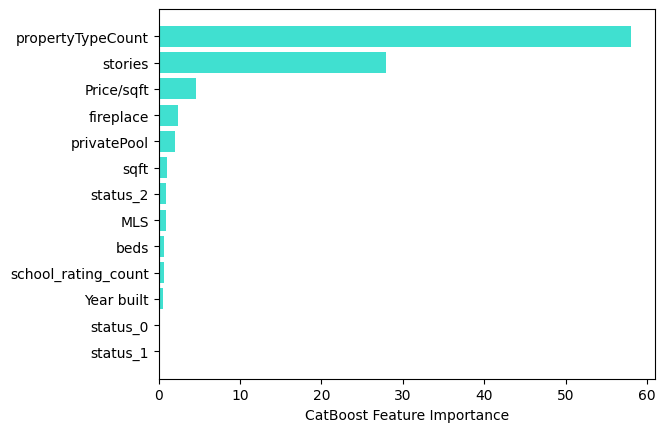

In [42]:
# визуализируем важность признаков для CatBoost
sorted_feature_importance = cb_model.feature_importances_.argsort()
plt.barh(X_train.columns[sorted_feature_importance], 
        cb_model.feature_importances_[sorted_feature_importance], 
        color='turquoise')
plt.xlabel("CatBoost Feature Importance")

Из всех испробованных мной вариантов по соотношению качество/времязатраты лучшие результаты показывает CatBoost. Очень хотелось воспользоваться им ранее, но я оставила его "на десерт", нужно же было попробовать что-то попроще. 

Также я пробовала строить модели на разных вариантах данных. В первом случае я очень бережливо к ним отнеслась, пыталась сохранить минимальные детали, и это, конечно же, было ни к чему, так как выбросы есть выбросы, поэтому на втором, более жестко очищенном от выбросов варианте модели работают лучше.

Надеюсь, мой потенциальный работдатель никогда не увидит этот проект.